<div dir='rtl'style="text-align: right;font-family:verdana;">
<h1>
قسمت اول
</h1>
در این قسمت ابتدا تعدادی از ماژول های لازم را import می کنیم (به علت این برخی سل ها را در پنجره های جداگانه ران کردیم و این فایل در چند روز پیاپی تهیه شده برخی از ماژول ها چند بار فراخوانی شده اند). سپس مدل خود را ساخته و دقت آن را ارزیابی می کنیم. <br>
برای ساخت مدل از CNN استفاده کردیم و در هر مرحله بر روی خروجی از Batch Normalization استفاده شده که مدل نهایی تا حد امکان بیش برازش اتفاق نیفتد. ااز رگیولاریزیشن استفاده نکردیم چون خروجی مدل به اندازه کافی خوب بود و استفاده از آن زمان بر بود. خروجی مدل دو کلاس مختلف دارد که بیانگر جنسیت تصویر ورودی است.
سعی کردیم تعدادی از هایپر پارامتر ها نزیر لرنینگ ریت و تعداد لایه ها  را از مقادیر موجود در مقالات استخراج کنیم، الیته می توانستیم از آموزش استفاده کنیم و مقادیر خوب را باتوجه به مدل و مسئله استخراج کنیم که با توجه به محدودیت سیستم و زمان این کار انجام پذیر نبود.
بعد از بررسی نتایج قسمت ۳ بنظر می رسد در فرایند آموزش یا داده ها کم بود است و به نوعی دچار بیش برازش شده ایم یا این که در مدل مشکلی وجود دارد و شاید خروجی مدل با انچه من فکر می کنم متفاوت است و من اشتباه از نتایج استفاده می کنم.
<br>
 تلاش های من برای بهبود مدل فقط روی خطای مدل بهبود حاصل کرد و اما درقسمت های بعدی تغییر محسوسی حاصل نشد.  
</div>

In [ ]:
from PIL import Image
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import os
from tensorflow.keras import regularizers
from keras.utils import np_utils
from keras.models import Sequential, load_model
from keras.layers import Dense, Dropout, Activation, Flatten
from keras.layers import Conv2D, MaxPooling2D, ZeroPadding2D, AveragePooling2D
import matplotlib.image as mpimg
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from tensorflow import keras
import IPython

%matplotlib inline

In [3]:
!pip install cvlib

     |████████████████████████████████| 10.1MB 4.4MB/s 
  Created wheel for cvlib: filename=cvlib-0.2.6-cp36-none-any.whl size=10044621 sha256=6b50ca1b89364cccef11536bf0ee44c6e923ab2014f5350a84414b8c58a62d02
  Stored in directory: /root/.cache/pip/wheels/5e/a4/99/8dfcae03a6f93bb4084650d0b642ef5a472429928fb95ffd01
  Created wheel for progressbar: filename=progressbar-2.5-cp36-none-any.whl size=12075 sha256=00ae454c428cf53a532db3fc4b03567a8e969544da976f8c99b299b4604826dd
  Stored in directory: /root/.cache/pip/wheels/c0/e9/6b/ea01090205e285175842339aa3b491adeb4015206cda272ff0
Successfully built cvlib progressbar


In [ ]:
from google.colab import drive
drive.mount('/gdrive')

In [ ]:
import matplotlib
matplotlib.use("Agg")
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras import regularizers
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.preprocessing.image import img_to_array
from keras.utils import to_categorical
from keras.utils import plot_model
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import numpy as np
import argparse
import random
import cv2
import os
import glob
from keras.models import Sequential
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import Conv2D
from keras.layers.convolutional import MaxPooling2D
from keras.layers.core import Activation
from keras.layers.core import Flatten
from keras.layers.core import Dropout
from keras.layers.core import Dense
from keras import backend as K


# initial parameters
epochs = 100
lr = 1e-3
batch_size = 64
img_dims = (96,96,3)





from keras.preprocessing.image import ImageDataGenerator

train_dir = "/gdrive/My Drive/gender/Training"
valid_dir = "/gdrive/My Drive/gender/Validation"



# Using imagedatagenerator to access the files and image augmentation.

# You can change the setting of imageDataGenerator for other augmentation methods.

train_datagen = ImageDataGenerator(rotation_range=20, zoom_range=0.15,
	width_shift_range=0.2, height_shift_range=0.2, shear_range=0.15,
	horizontal_flip=True,rescale=1/255)
test_datagen = ImageDataGenerator(rotation_range=20, zoom_range=0.15,
	width_shift_range=0.2, height_shift_range=0.2, shear_range=0.15,
	horizontal_flip=True,rescale=1/255)


# build model

training_generator = train_datagen.flow_from_directory(train_dir,
                                                       batch_size = 32,
                                                      target_size=(96, 96),
                                                      class_mode="categorical")


valid_generator = test_datagen.flow_from_directory(valid_dir,
                                                   batch_size = 32,
                                                       target_size=(96, 96),
                                                       class_mode="categorical")


model = Sequential()
chanDim = -1
model.add(Conv2D(32, (3,3), padding="same", input_shape=(96,96,3)))
model.add(Activation("relu"))
model.add(BatchNormalization(axis=chanDim))
model.add(MaxPooling2D(pool_size=(3,3)))
model.add(Dropout(0.25))

model.add(Conv2D(64, (3,3), padding="same"))
model.add(Activation("relu"))
model.add(BatchNormalization(axis=chanDim))
model.add(Conv2D(64, (3,3), padding="same"))
model.add(Activation("relu"))
model.add(BatchNormalization(axis=chanDim))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Conv2D(128, (3,3), padding="same"))
model.add(Activation("relu"))
model.add(BatchNormalization(axis=chanDim))
model.add(Conv2D(128, (3,3), padding="same"))
model.add(Activation("relu"))
model.add(BatchNormalization(axis=chanDim))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(1024))
model.add(Activation("relu"))
model.add(BatchNormalization())
model.add(Dropout(0.5))
model.add(Dense(2))
model.add(Activation("sigmoid"))





# compile the model
opt = Adam(lr=lr, decay=lr/epochs)
model.compile(loss="binary_crossentropy", optimizer=opt, metrics=["accuracy"])

# train the model

STEP_SIZE_TRAIN=training_generator.n//training_generator.batch_size
STEP_SIZE_VALID=valid_generator.n//valid_generator.batch_size
H = model.fit_generator(generator=training_generator,
steps_per_epoch=STEP_SIZE_TRAIN,
validation_data=valid_generator,
validation_steps=STEP_SIZE_VALID,epochs=4)

# save the model to disk
model.save('main.h5')


Found 22667 images belonging to 2 classes.
Found 5472 images belonging to 2 classes.


/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/training.py:1844: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/4
708/708 [==============================] - 766s 1s/step - loss: 0.6516 - accuracy: 0.7254 - val_loss: 0.7676 - val_accuracy: 0.7167
Epoch 2/4
708/708 [==============================] - 772s 1s/step - loss: 0.2694 - accuracy: 0.8957 - val_loss: 0.1853 - val_accuracy: 0.9227
Epoch 3/4
708/708 [==============================] - 771s 1s/step - loss: 0.2111 - accuracy: 0.9182 - val_loss: 0.2103 - val_accuracy: 0.9309
Epoch 4/4
708/708 [==============================] - 768s 1s/step - loss: 0.2115 - accuracy: 0.9181 - val_loss: 0.2713 - val_accuracy: 0.8962


<div dir='rtl'style="text-align: right;font-family:verdana;">

ما با استفاده از 5 epoch توانستیم دقت بهتری نیز از مدلمان بدست بیاوریم اما برای محدودیت زمانی در این قسمت به 4 مرحله اکتفا کردیم.<br>
نتایج زمانی که 5 epoch اجرا شد متاسفانه پاک شدند ولی دقت حدودا 1 در روی ترین و 5 درصد روی داده های ولید از این نتایج بیشتر بود.<br>
می توان نمودار دقت مدل را بصورت زیر رسم کرد. برای مشاهده به فایل عکس ارسال شده در پوشه جواب مشاهده کنید.
</div>

In [ ]:
plt.style.use("ggplot")
plt.figure(figsize = (10,10))
N = 4
plt.plot(np.arange(0,N), H.history["loss"], label="train_loss")
plt.plot(np.arange(0,N), H.history["val_loss"], label="val_loss")

plt.title("Training Loss")
plt.xlabel("Epoch #")
plt.ylabel("Loss")
plt.legend(loc="upper right")

plt.ylim([0, 2.5])
plt.savefig('plot')

<div dir='rtl'style="text-align: right;font-family:verdana;">
<h1>
قسمت دوم
</h1>
در این قسمت از مدل معروف که برای تشخیص جنسیت تصاویر استفاده می شود استفاده کردیم. برای این کار از لینک مدل استفاده کردیم و آن را دانلود و لود کردیم در این قسمت ما دو کار می توانستیم بکنیم:
1) یکی از تصاویر موجود در دیتاست ترین یا ولیدیشن را بطور مستقیم به مدل بدهیم. <br>
2) صورت های موجود در یک تصویر را پیدا کرده و از مدل بخواهیم جنسیت هر کدام را مشخص کند.
از آنجا که عنوان این تمرین detection است نه classfication  بنابراین در یک عکس تصاویر را پیدا کرده و با مدل معروفمان جنسیت هر کدام را مشخص می کنیم. برای نمایش هم صورت افراد مشخص شده در تصویر به همراه جنسیتشان را روی تصویر اصلی نشان می دهیم.
</div>

<div dir='rtl'style="text-align: right;font-family:verdana;">
یک مدل معروف که با استفاده از آن می توان جنسیت یک تصویر را بدست آورد، در ادامه آورده شده است.
</div>


[2.1500423e-06 9.9999714e-01]
['man', 'woman']
[6.4905844e-06 9.9999070e-01]
['man', 'woman']


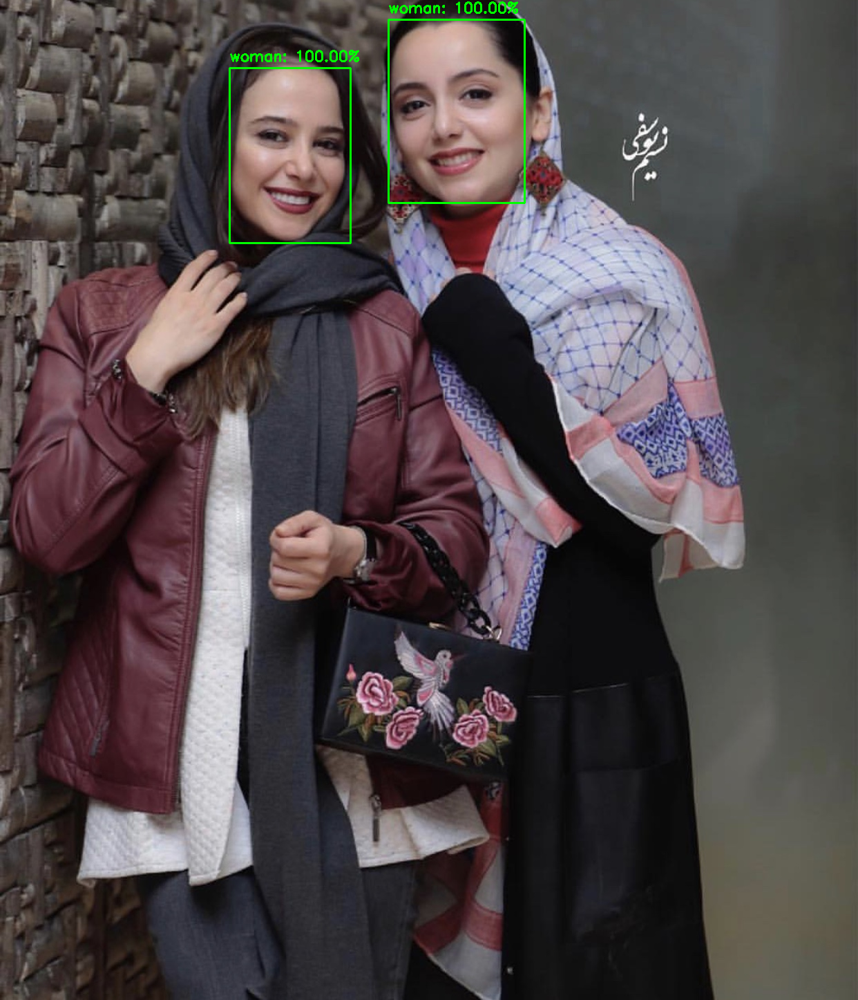

In [2]:
from keras.preprocessing.image import img_to_array
from keras.models import load_model
from keras.utils import get_file
import numpy as np
import argparse
import cv2
import os
import cvlib as cv

dwnld_link = "https://github.com/GilLevi/AgeGenderDeepLearning/raw/master/models/gender_net.caffemodel"
model_path = get_file("gender_detection.model", dwnld_link,
                     cache_subdir="pre-trained", cache_dir=os.getcwd())
image = cv2.imread("1.jpg")
if image is None:
    print("Could not read input image")
    exit()
model = load_model(model_path)
face, confidence = cv.detect_face(image)
classes = ['man','woman']
for idx, f in enumerate(face):
    (startX, startY) = f[0], f[1]
    (endX, endY) = f[2], f[3]
    cv2.rectangle(image, (startX,startY), (endX,endY), (0,255,0), 2)
    face_crop = np.copy(image[startY:endY,startX:endX])
    face_crop = cv2.resize(face_crop, (96,96))
    face_crop = face_crop.astype("float") / 255.0
    face_crop = img_to_array(face_crop)
    face_crop = np.expand_dims(face_crop, axis=0)
    conf = model.predict(face_crop)[0]
    print(conf)
    print(classes)
    idx = np.argmax(conf)
    label = classes[idx]
    label = "{}: {:.2f}%".format(label, conf[idx] * 100)
    Y = startY - 10 if startY - 10 > 10 else startY + 10
    cv2.putText(image, label, (startX, Y),  cv2.FONT_HERSHEY_SIMPLEX,
                0.7, (0, 255, 0), 2)
from google.colab.patches import cv2_imshow
cv2_imshow( image)
cv2.waitKey()
cv2.imwrite("gender_detection.jpg", image)
cv2.destroyAllWindows()

<div dir='rtl'style="text-align: right;font-family:verdana;">
<h1>
قسمت سوم الف
</h1>
استخراج چهره خودم و استفاده از مدل پیشنهادی برای تشخیص جنسیت.

</div>

[5.8290498e-05 9.9994767e-01]
['man', 'woman']


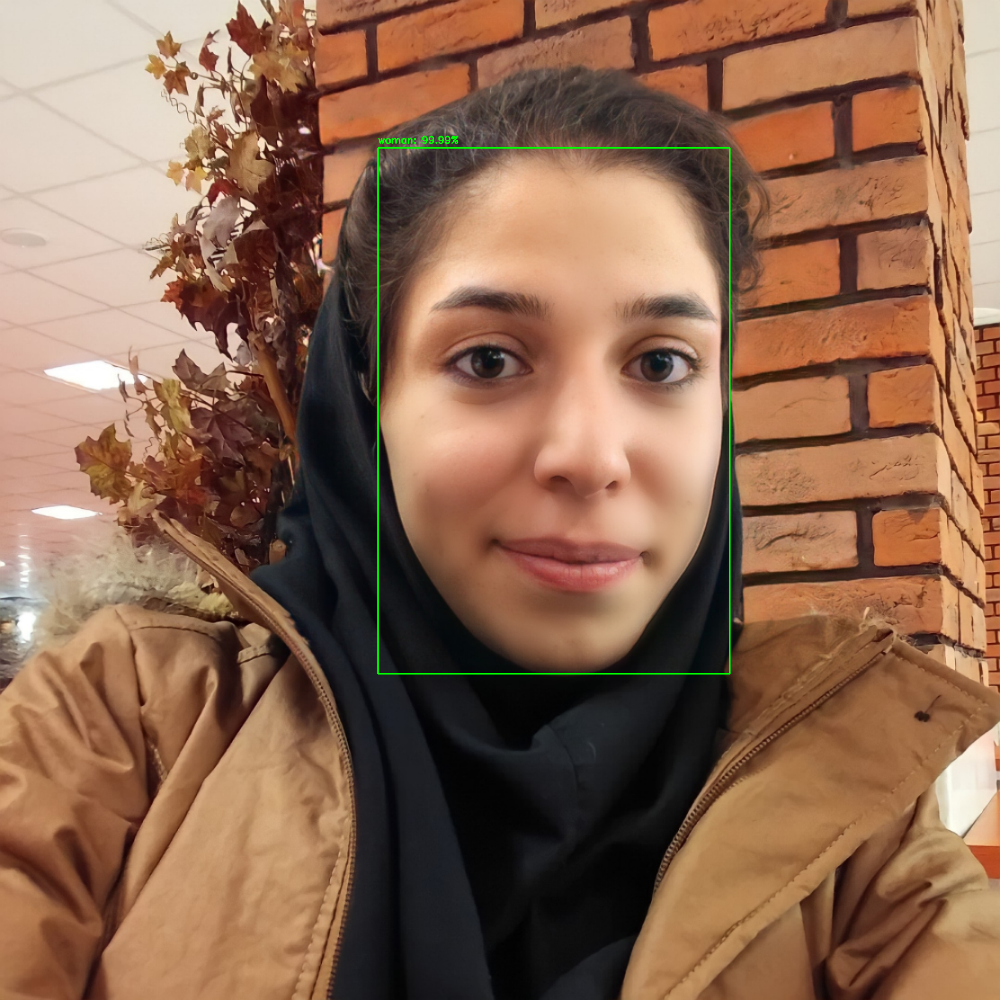

In [17]:
from keras.preprocessing.image import img_to_array
from keras.models import load_model
from keras.utils import get_file
import numpy as np
import argparse
import cv2
import os
import cvlib as cv

dwnld_link = "https://github.com/GilLevi/AgeGenderDeepLearning/raw/master/models/gender_net.caffemodel"
model_path = get_file("gender_detection.model", dwnld_link,
                     cache_subdir="pre-trained", cache_dir=os.getcwd())

model = load_model(model_path)

image = cv2.imread("22.jpg")
face, confidence = cv.detect_face(image)

classes = ['man','woman']

# loop through detected faces
for idx, f in enumerate(face):

     # get corner points of face rectangle       
    (startX, startY) = f[0], f[1]
    (endX, endY) = f[2], f[3]

    # draw rectangle over face
    cv2.rectangle(image, (startX,startY), (endX,endY), (0,255,0), 2)

    # crop the detected face region
    face_crop = np.copy(image[startY:endY,startX:endX])

    # preprocessing for gender detection model
    face_crop = cv2.resize(face_crop, (96,96))
    face_crop = face_crop.astype("float") / 255.0
    face_crop = img_to_array(face_crop)
    face_crop = np.expand_dims(face_crop, axis=0)

    # apply gender detection on face
    conf = model.predict(face_crop)[0]
    print(conf)
    print(classes)

    # get label with max accuracy
    idx = np.argmax(conf)
    label = classes[idx]

    label = "{}: {:.2f}%".format(label, conf[idx] * 100)

    Y = startY - 10 if startY - 10 > 10 else startY + 10

    # write label and confidence above face rectangle
    cv2.putText(image, label, (startX, Y),  cv2.FONT_HERSHEY_SIMPLEX,
                0.7, (0, 255, 0), 2)

# display output
from google.colab.patches import cv2_imshow
cv2_imshow( image)

# press any key to close window           
cv2.waitKey()

# save output
cv2.imwrite("gender_detection.jpg", image)

# release resources
cv2.destroyAllWindows()

<div dir='rtl'style="text-align: right;font-family:verdana;">
بنظر می رسد در آموزش مدل یک مشکل کلیدی وجود دارد! از آنجایی که دقت مدل خوب گزارش شد و الان نتایج بدست آمده نشان می دهد که دقت کافی ندارد. من تغییری در نوع متغیر های ترین و ولید به باینی و همچنین کاهش کلاس خروجی به یک کلاس انجام دادم و نتایج بدتر شد بنابر این به این مدل اکتفا کردم لازم به ذکر است که در قسمت اول تها اشاره ای به نتایج متناقض شد.
</div>



[0.5709969]
['man', 'woman']


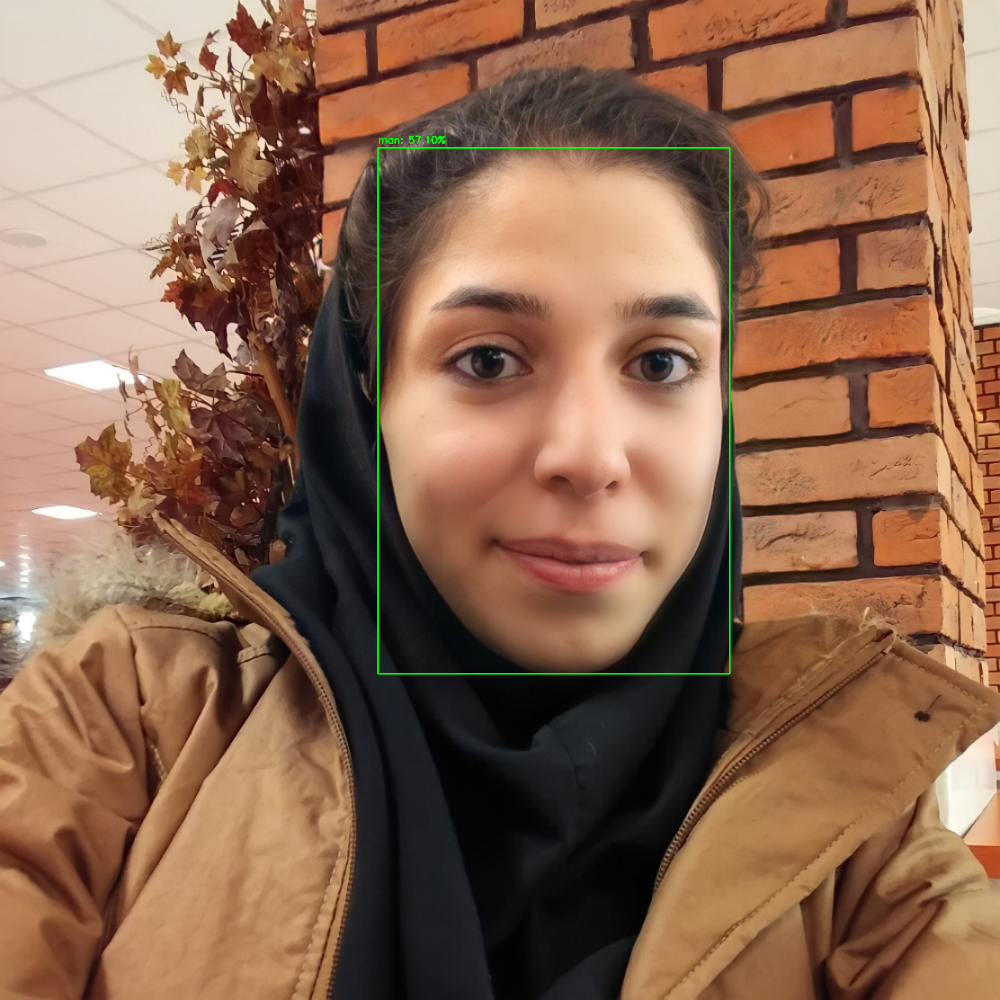

In [5]:
from keras.preprocessing.image import img_to_array
from keras.models import load_model
from keras.utils import get_file
import numpy as np
import argparse
import cv2
import os
import cvlib as cv

model = load_model('main (1).h5')

image = cv2.imread("22.jpg")
face, confidence = cv.detect_face(image)

classes = ['man','woman']

# loop through detected faces
for idx, f in enumerate(face):

     # get corner points of face rectangle       
    (startX, startY) = f[0], f[1]
    (endX, endY) = f[2], f[3]

    # draw rectangle over face
    cv2.rectangle(image, (startX,startY), (endX,endY), (0,255,0), 2)

    # crop the detected face region
    face_crop = np.copy(image[startY:endY,startX:endX])

    # preprocessing for gender detection model
    face_crop = cv2.resize(face_crop, (96,96))
    face_crop = face_crop.astype("float") / 255.0
    face_crop = img_to_array(face_crop)
    face_crop = np.expand_dims(face_crop, axis=0)

    # apply gender detection on face
    conf = model.predict(face_crop)[0]
    print(conf)
    print(classes)

    # get label with max accuracy
    idx = np.argmax(conf)
    label = classes[idx]

    label = "{}: {:.2f}%".format(label, conf[idx] * 100)

    Y = startY - 10 if startY - 10 > 10 else startY + 10

    # write label and confidence above face rectangle
    cv2.putText(image, label, (startX, Y),  cv2.FONT_HERSHEY_SIMPLEX,
                0.7, (0, 255, 0), 2)

# display output
from google.colab.patches import cv2_imshow
cv2_imshow( image)

# press any key to close window           
cv2.waitKey()

# save output
cv2.imwrite("gender_detection.jpg", image)

# release resources
cv2.destroyAllWindows()

<div dir='rtl'style="text-align: right;font-family:verdana;">
<h1>
قسمت سوم ب
</h1>
20 تصویر از  بازیگران ایرانی که در ادامه جنسیت هر شخص را در تصویر با مدل پیشنهادی مشخص کردیم.<br>
در این قسمت نیز نتایج حاصل از یادگیری انتقالی بسیار خوب عمل کردند و نتایج جالب بود اما نتایج حاصل از مدل ما اصلا رضایت بخش نبودند!
</div>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


[2.1500423e-06 9.9999714e-01]
['man', 'woman']
[6.4905844e-06 9.9999070e-01]
['man', 'woman']


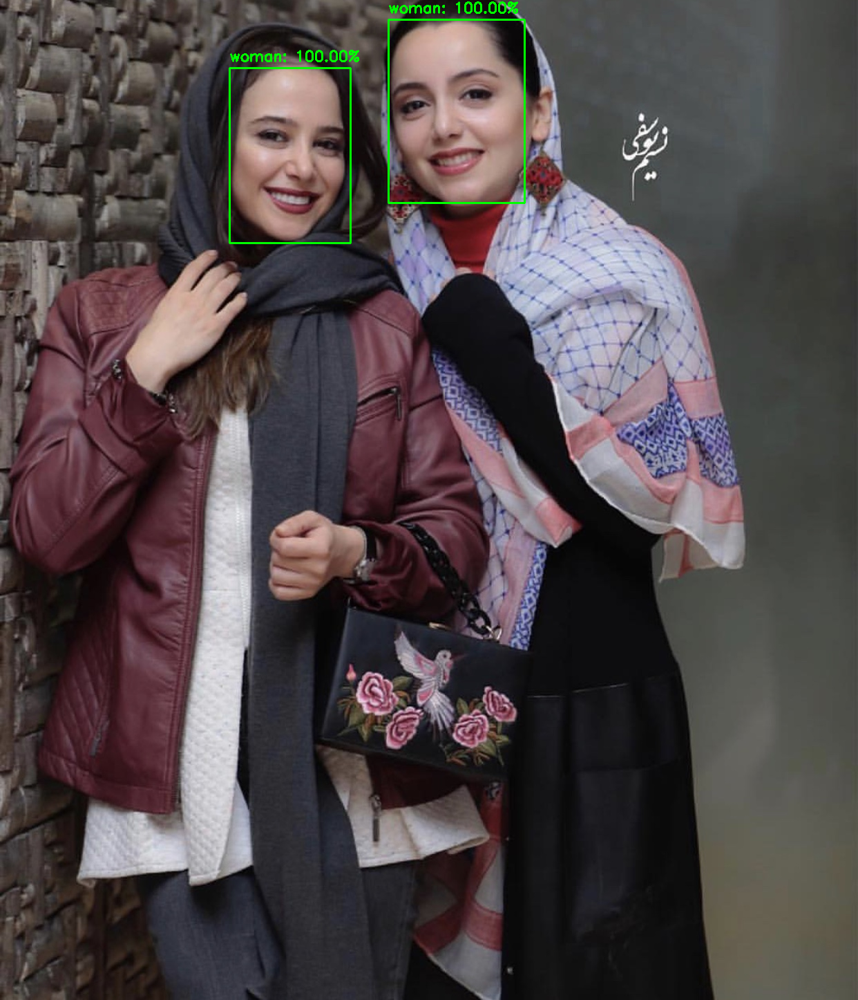

[2.2510835e-06 9.9999821e-01]
['man', 'woman']
[0.00454348 0.99567676]
['man', 'woman']


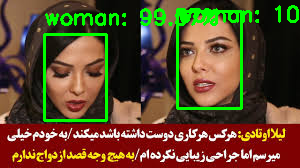

[2.8870352e-06 9.9999654e-01]
['man', 'woman']


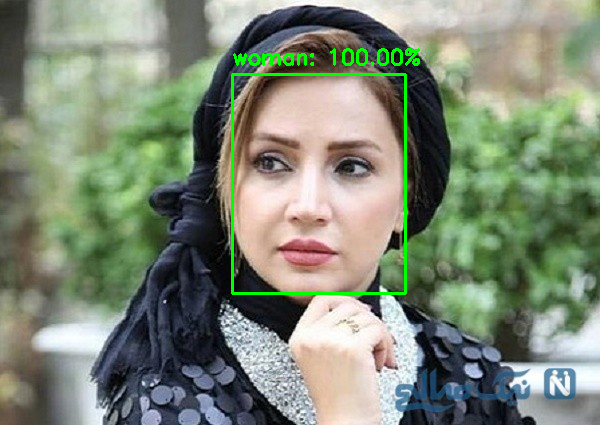

[9.999888e-01 5.642657e-06]
['man', 'woman']
[1.0000000e+00 2.1306965e-11]
['man', 'woman']
[0.99702716 0.00378984]
['man', 'woman']
[0.00307018 0.996919  ]
['man', 'woman']


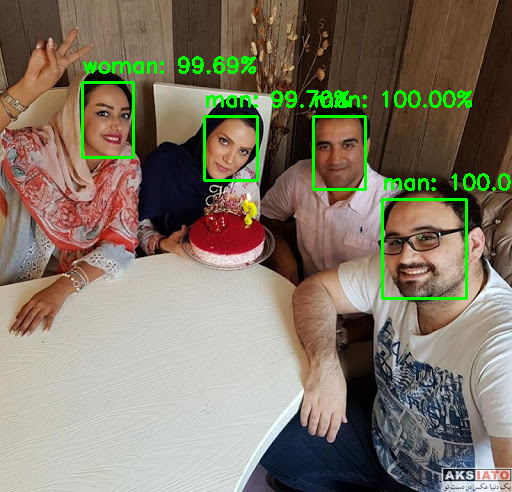

[1.000000e+00 4.405634e-10]
['man', 'woman']
[0.00235304 0.9968138 ]
['man', 'woman']


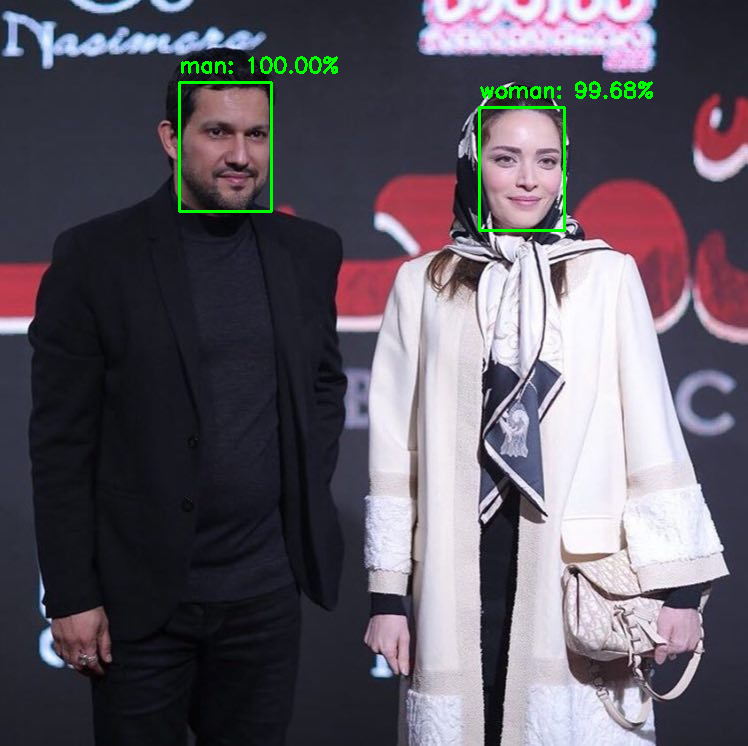

[7.6528227e-07 9.9999928e-01]
['man', 'woman']


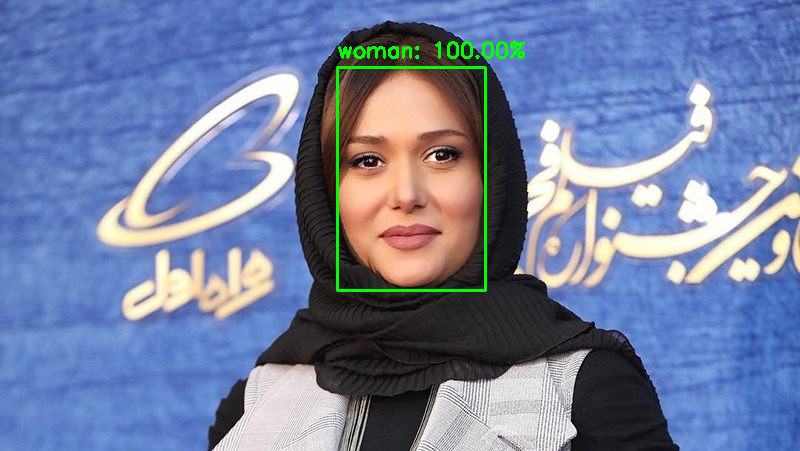

[1.0000000e+00 1.2686476e-11]
['man', 'woman']
[1.000000e+00 4.597137e-13]
['man', 'woman']
[1.000000e+00 3.835793e-14]
['man', 'woman']
[1.0000000e+00 2.5162127e-14]
['man', 'woman']
[1.0000000e+00 2.7602729e-11]
['man', 'woman']


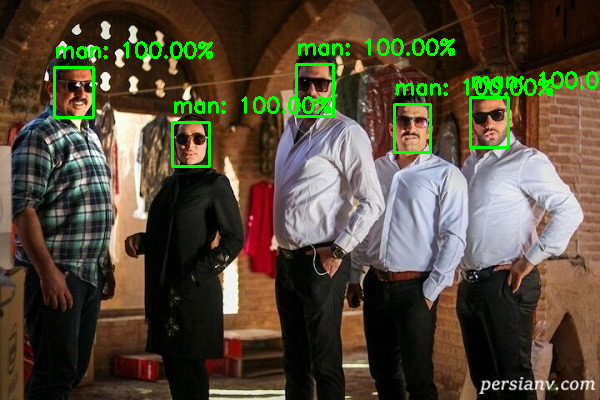

[9.9991417e-01 6.6596695e-05]
['man', 'woman']
[1.000000e+00 1.060643e-09]
['man', 'woman']
[1.000000e+00 7.536461e-11]
['man', 'woman']
[0.01219073 0.9867983 ]
['man', 'woman']


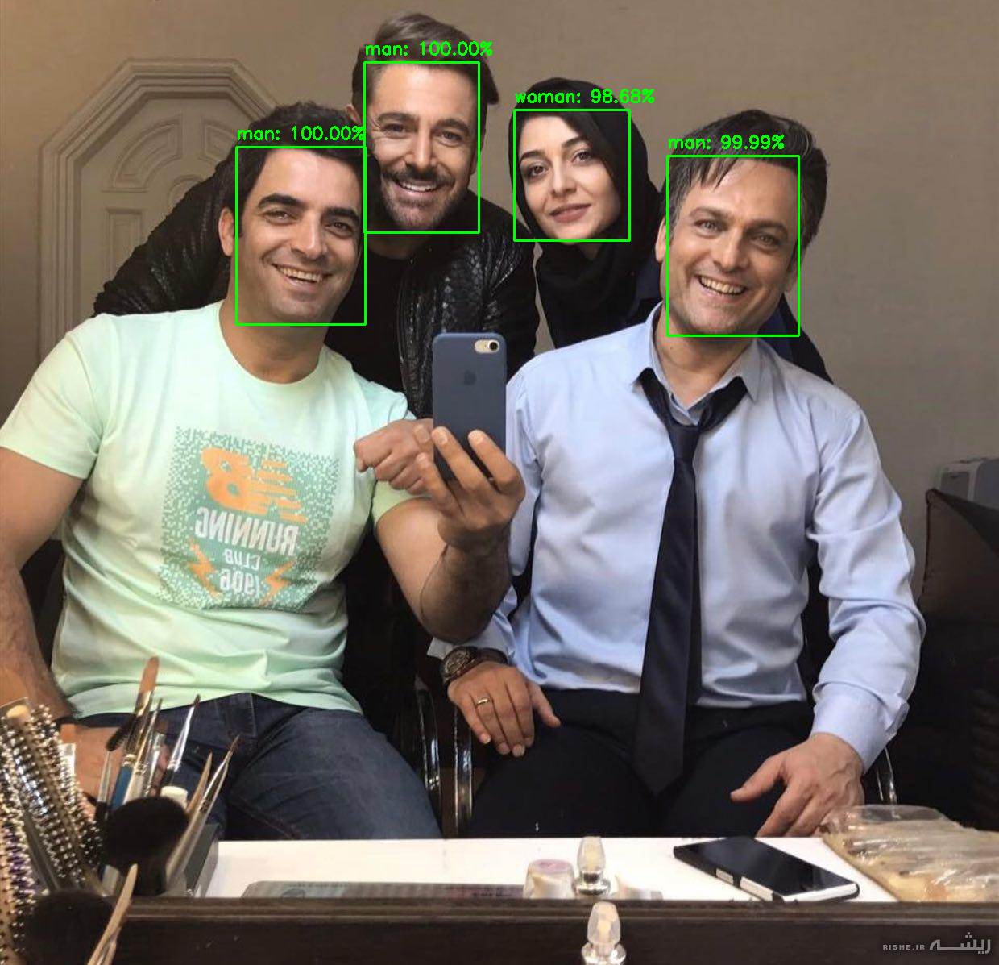

[0.06699914 0.9372251 ]
['man', 'woman']
[1.0000000e+00 4.3640597e-10]
['man', 'woman']
[0.6457162 0.3599207]
['man', 'woman']
[9.9996787e-01 3.4357367e-05]
['man', 'woman']


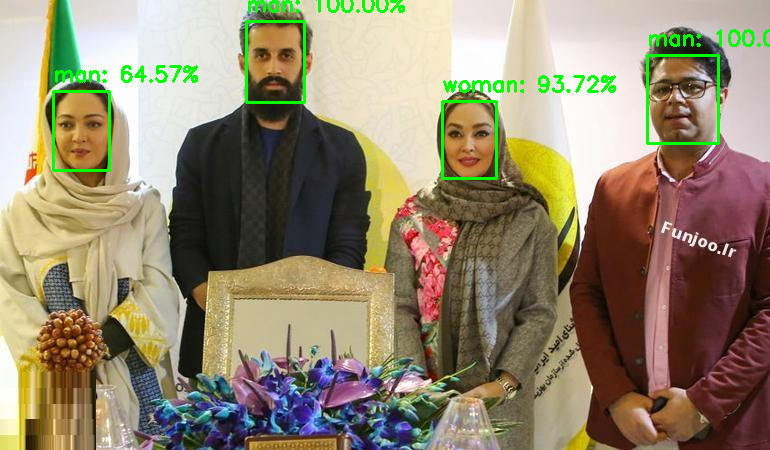

[0.01725739 0.98572063]
['man', 'woman']
[1.000000e+00 4.463612e-19]
['man', 'woman']


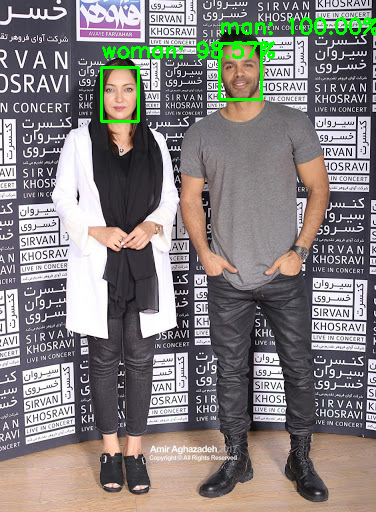

[0.15515015 0.8450258 ]
['man', 'woman']
[1.0000000e+00 3.9421932e-10]
['man', 'woman']


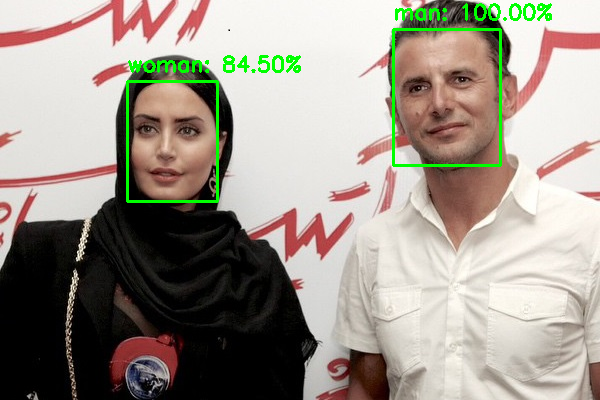

[5.8453883e-05 9.9992812e-01]
['man', 'woman']


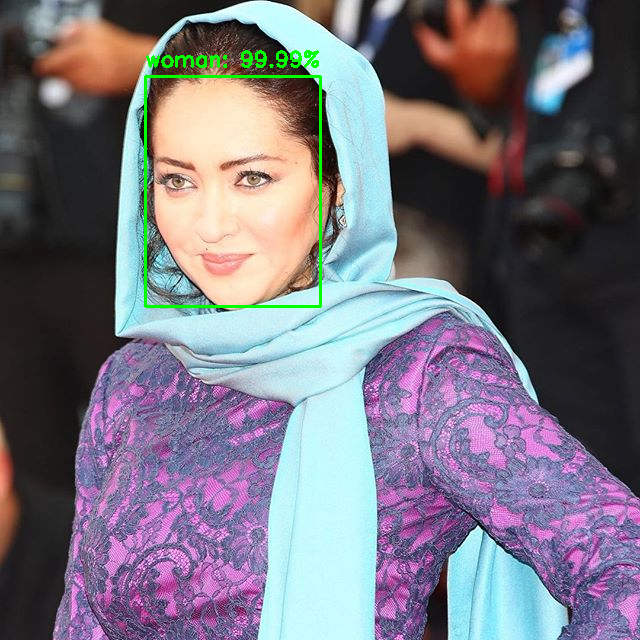

[9.9999976e-01 1.3755448e-07]
['man', 'woman']


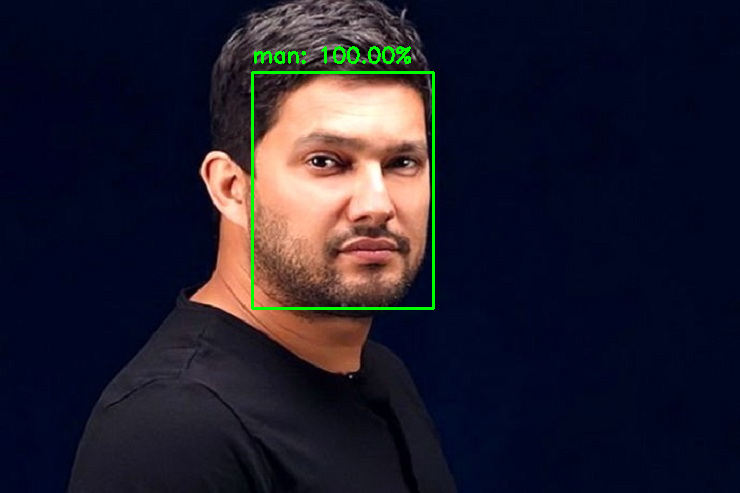

[1.0000000e+00 1.2255361e-12]
['man', 'woman']
[1.0000000e+00 4.2165643e-18]
['man', 'woman']
[9.9998498e-01 1.0147363e-05]
['man', 'woman']


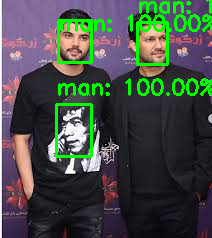

[1.0000000e+00 1.0370692e-10]
['man', 'woman']
[1.0000000e+00 3.0423277e-12]
['man', 'woman']
[1.0000000e+00 2.8828682e-09]
['man', 'woman']
[1.0000000e+00 1.6241505e-16]
['man', 'woman']


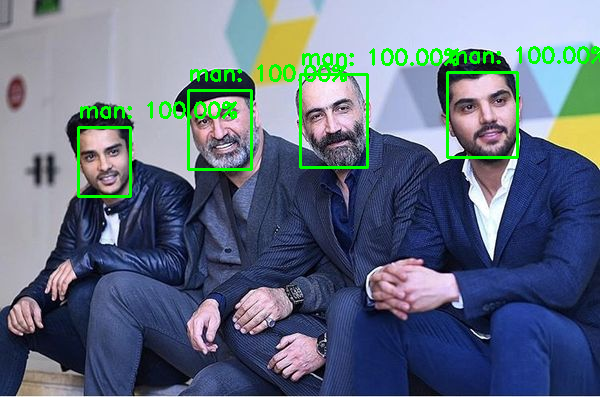

[3.6854043e-08 1.0000000e+00]
['man', 'woman']
[1.0000000e+00 3.1289375e-08]
['man', 'woman']
[1.3896823e-04 9.9984157e-01]
['man', 'woman']


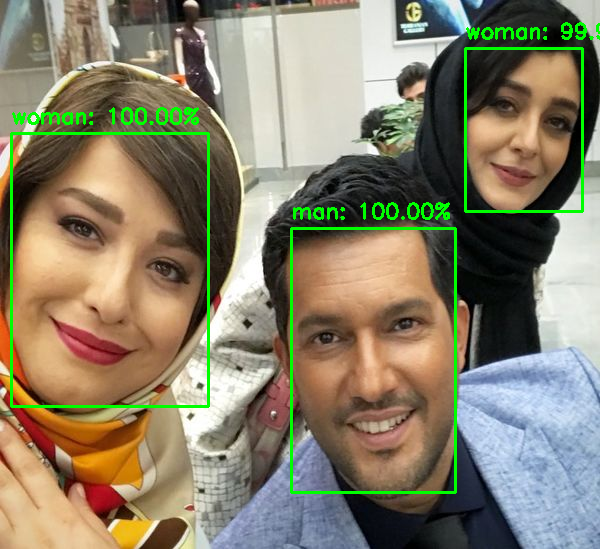

[0.00477055 0.99494684]
['man', 'woman']
[1.0000000e+00 2.2361368e-09]
['man', 'woman']
[6.8280101e-04 9.9924994e-01]
['man', 'woman']
[0.01560432 0.9863368 ]
['man', 'woman']
[1.0000000e+00 3.0351686e-09]
['man', 'woman']
[9.999560e-01 4.149304e-05]
['man', 'woman']


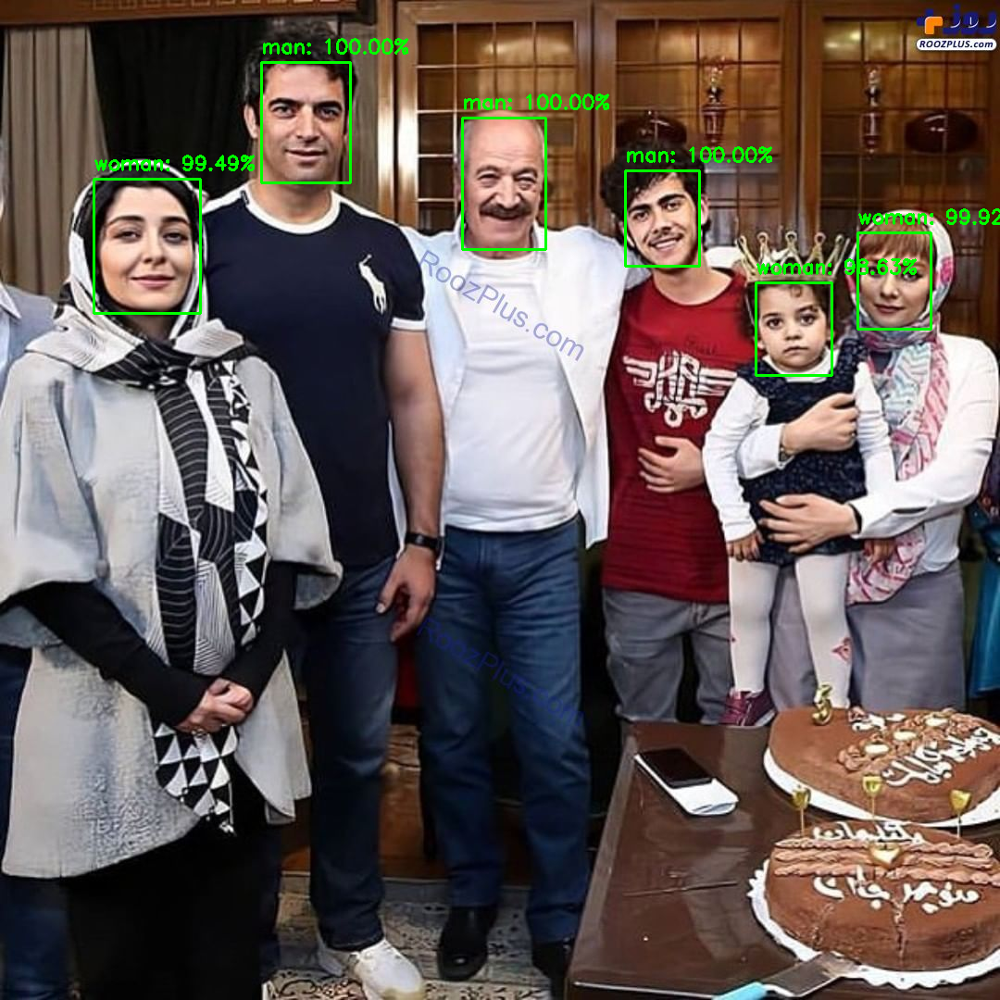

[9.999992e-01 5.291323e-07]
['man', 'woman']
[4.988252e-07 9.999993e-01]
['man', 'woman']
[9.9999964e-01 3.4067534e-07]
['man', 'woman']
[9.9648794e-05 9.9989402e-01]
['man', 'woman']


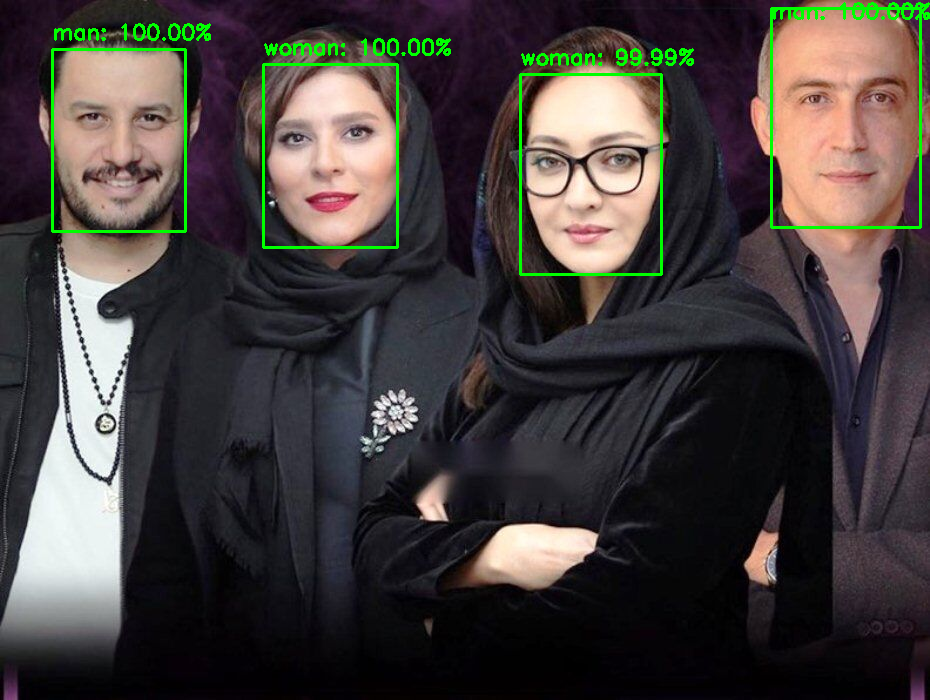

[0.00853693 0.9895991 ]
['man', 'woman']
[0.00119853 0.9987582 ]
['man', 'woman']
[0.09782004 0.90898067]
['man', 'woman']


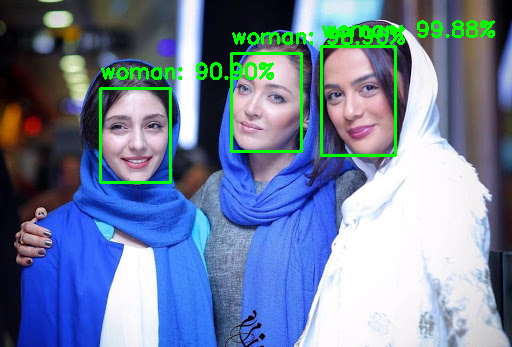

[9.999912e-01 9.690256e-06]
['man', 'woman']
[1.000000e+00 1.002155e-09]
['man', 'woman']


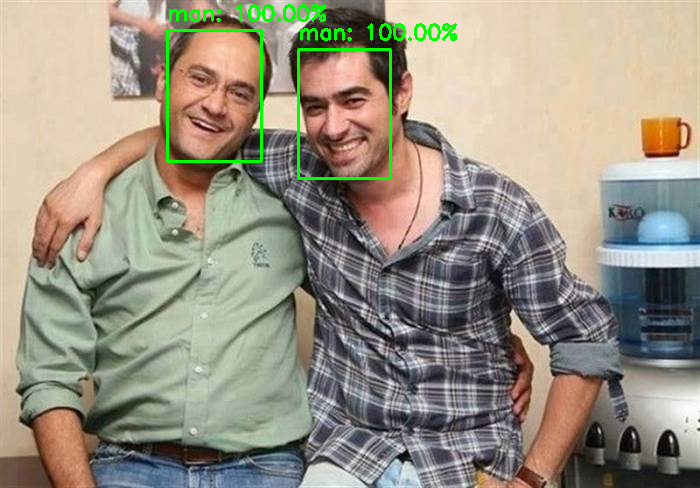

In [6]:
from keras.preprocessing.image import img_to_array
from keras.models import load_model
from keras.utils import get_file
import numpy as np
import argparse
import cv2
import os
import cvlib as cv

dwnld_link = "https://github.com/GilLevi/AgeGenderDeepLearning/raw/master/models/gender_net.caffemodel"
model_path = get_file("gender_detection.model", dwnld_link,
                     cache_subdir="pre-trained", cache_dir=os.getcwd())

model = load_model(model_path)
for i in range(1,21):                  
  image = cv2.imread("{0}.jpg".format(i))
  if image is None:
      print("Could not read input image")
      exit()
  face, confidence = cv.detect_face(image)
  classes = ['man','woman']
  for idx, f in enumerate(face):
      (startX, startY) = f[0], f[1]
      (endX, endY) = f[2], f[3]
      cv2.rectangle(image, (startX,startY), (endX,endY), (0,255,0), 2)
      face_crop = np.copy(image[startY:endY,startX:endX])
      face_crop = cv2.resize(face_crop, (96,96))
      face_crop = face_crop.astype("float") / 255.0
      face_crop = img_to_array(face_crop)
      face_crop = np.expand_dims(face_crop, axis=0)
      conf = model.predict(face_crop)[0]
      print(conf)
      print(classes)
      idx = np.argmax(conf)
      label = classes[idx]
      label = "{}: {:.2f}%".format(label, conf[idx] * 100)
      Y = startY - 10 if startY - 10 > 10 else startY + 10
      cv2.putText(image, label, (startX, Y),  cv2.FONT_HERSHEY_SIMPLEX,
                  0.7, (0, 255, 0), 2)
  from google.colab.patches import cv2_imshow
  cv2_imshow( image)
  cv2.waitKey()
  cv2.imwrite("gender_detection.jpg", image)
  cv2.destroyAllWindows()

[0.5575377  0.45184052]
['man', 'woman']
[0.94729114 0.05801895]
['man', 'woman']


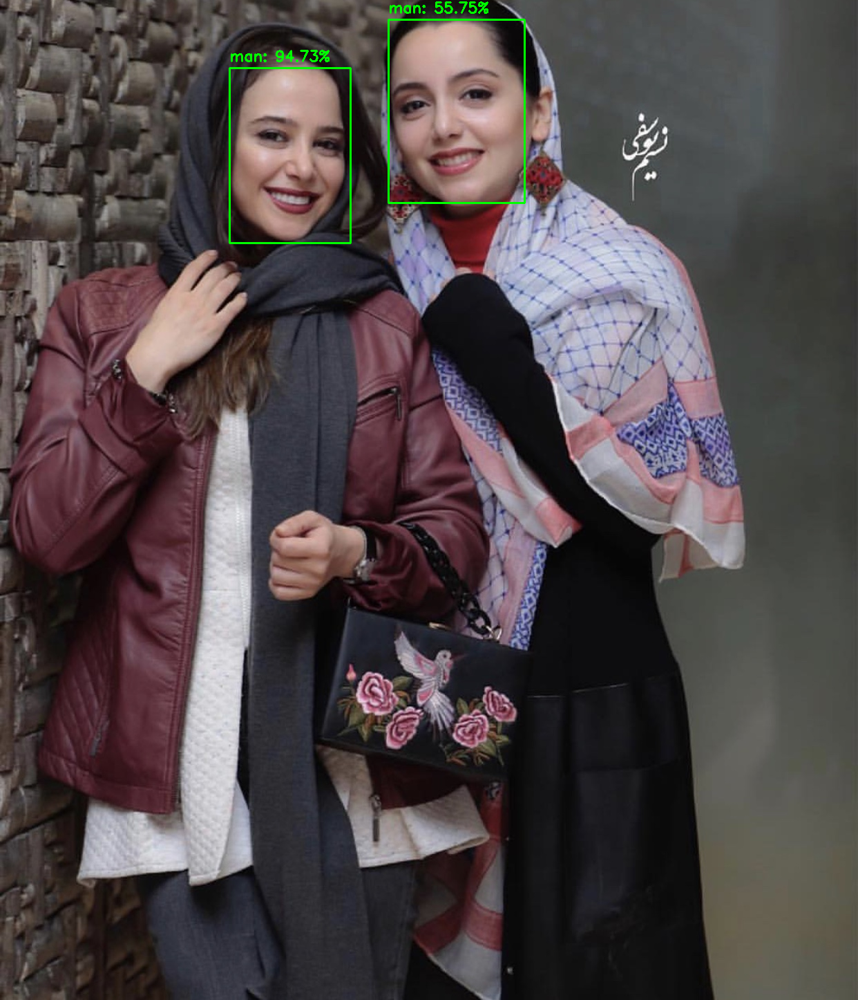

[0.289343 0.7097  ]
['man', 'woman']
[0.28958756 0.7102497 ]
['man', 'woman']


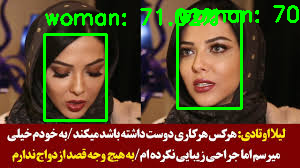

[0.5973446 0.3853862]
['man', 'woman']


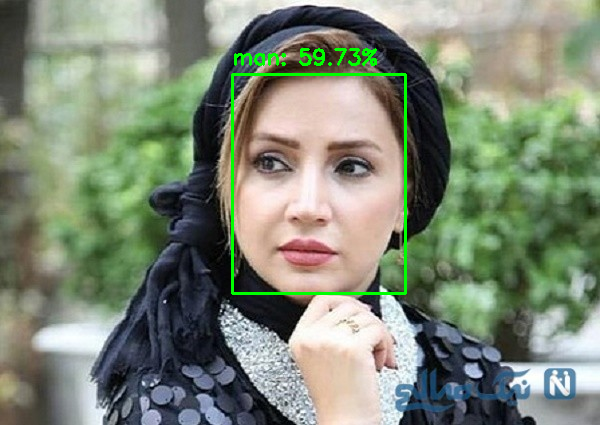

[0.0286715  0.97235024]
['man', 'woman']
[0.05450237 0.94595116]
['man', 'woman']
[0.20872307 0.79664576]
['man', 'woman']
[0.2317639 0.775427 ]
['man', 'woman']


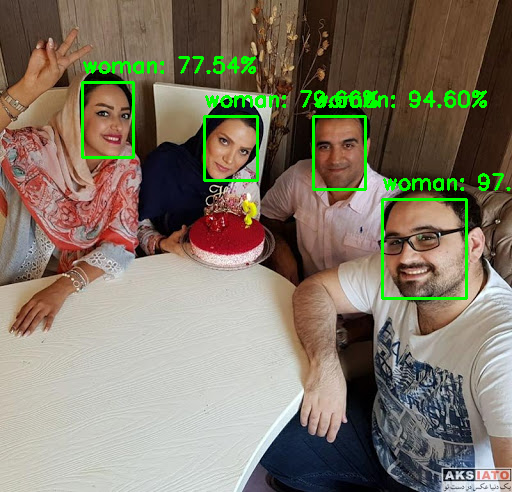

[0.0359861 0.9690876]
['man', 'woman']
[0.14476895 0.842677  ]
['man', 'woman']


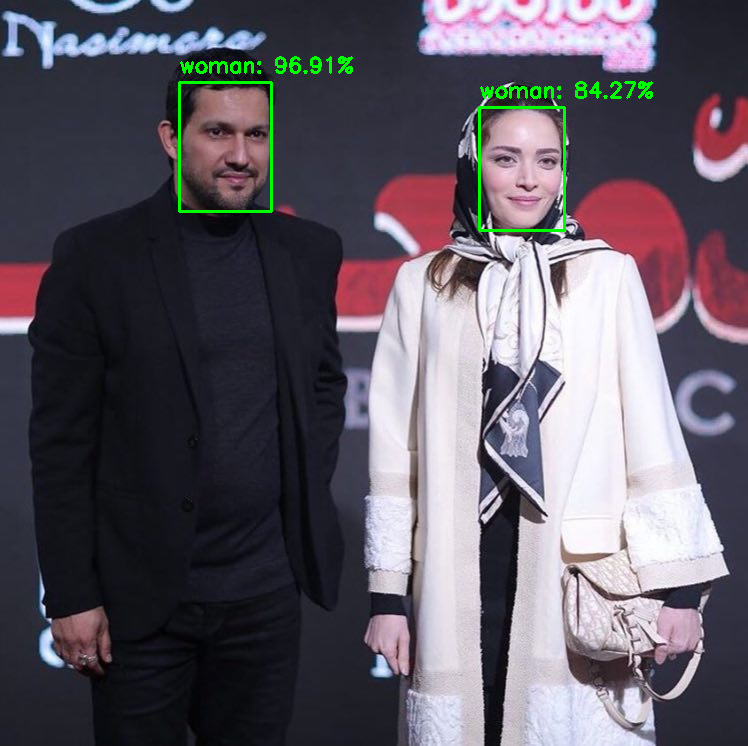

[0.6970595  0.30468577]
['man', 'woman']


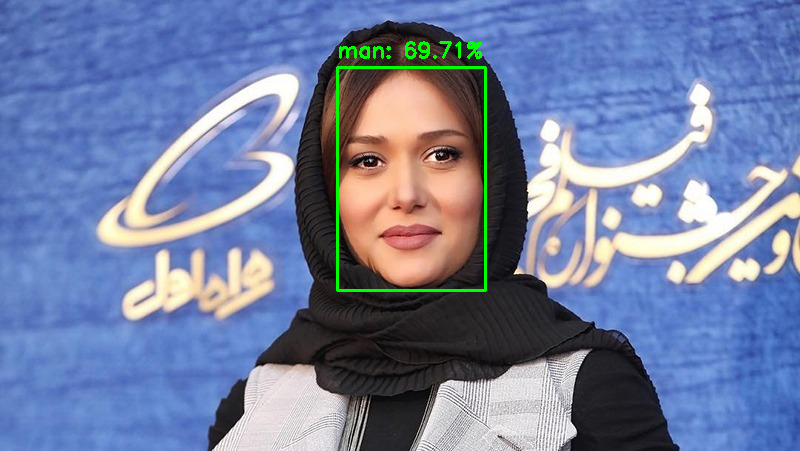

[0.12211251 0.8667321 ]
['man', 'woman']
[0.05605277 0.9389756 ]
['man', 'woman']
[0.06259745 0.92695475]
['man', 'woman']
[0.13187084 0.8556546 ]
['man', 'woman']
[0.15322492 0.8229888 ]
['man', 'woman']


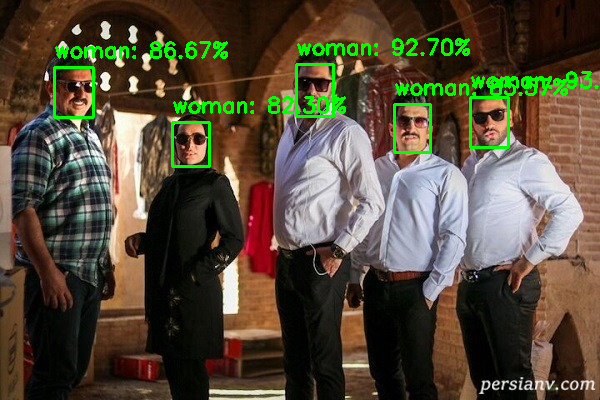

[0.11696124 0.88984436]
['man', 'woman']
[0.09758967 0.9102139 ]
['man', 'woman']
[0.05539301 0.94451535]
['man', 'woman']
[0.5909499 0.4280088]
['man', 'woman']


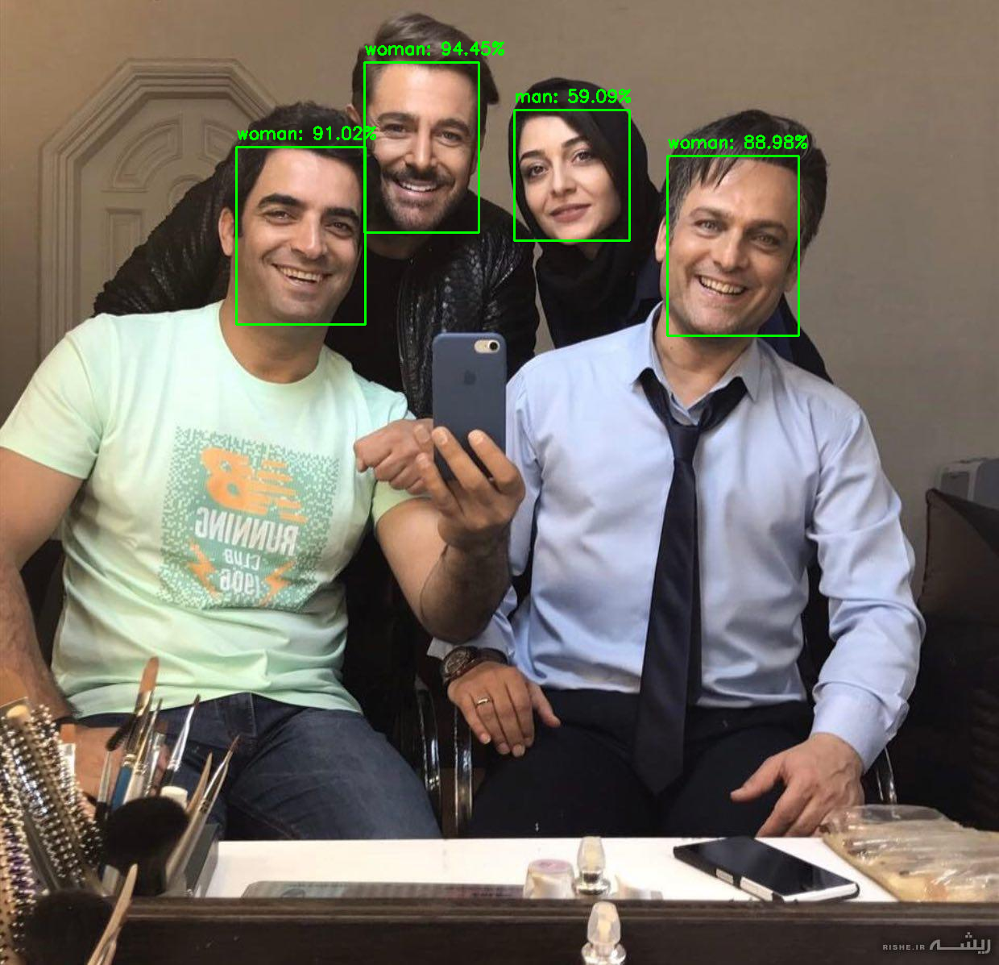

In [ ]:
from keras.preprocessing.image import img_to_array
from keras.models import load_model
from keras.utils import get_file
import numpy as np
import argparse
import cv2
import os
import cvlib as cv



# load pre-trained model
model = load_model('main (1).h5')
for i in range(1,21):                  
  image = cv2.imread("{0}.jpg".format(i))
  if image is None:
      print("Could not read input image")
      exit()
  face, confidence = cv.detect_face(image)
  classes = ['man','woman']
  for idx, f in enumerate(face):
      (startX, startY) = f[0], f[1]
      (endX, endY) = f[2], f[3]
      cv2.rectangle(image, (startX,startY), (endX,endY), (0,255,0), 2)
      face_crop = np.copy(image[startY:endY,startX:endX])
      face_crop = cv2.resize(face_crop, (96,96))
      face_crop = face_crop.astype("float") / 255.0
      face_crop = img_to_array(face_crop)
      face_crop = np.expand_dims(face_crop, axis=0)
      conf = model.predict(face_crop)[0]
      print(conf)
      print(classes)
      idx = np.argmax(conf)
      label = classes[idx]
      label = "{}: {:.2f}%".format(label, conf[idx] * 100)
      Y = startY - 10 if startY - 10 > 10 else startY + 10
      cv2.putText(image, label, (startX, Y),  cv2.FONT_HERSHEY_SIMPLEX,
                  0.7, (0, 255, 0), 2)
  from google.colab.patches import cv2_imshow
  cv2_imshow( image)
  cv2.waitKey()
  cv2.imwrite("gender_detection.jpg", image)
  cv2.destroyAllWindows()



```
# This is formatted as code
```

